# Describe Synechococcus and the Environment at MVCO

## importing Syn data and organizing the dataframe


1. Syn Abundance (48 hour running mean resolution)

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates #for working with dates in plots
import seaborn as sns
from calendar import month_name as mn
import datetime
from matplotlib.dates import MonthLocator, DateFormatter
import numpy as np



date = pd.read_csv("/D/MIT-WHOI/github_repos/syn_model/data/alldatenum.txt",sep = "/t",header = None,names = ["date"])
synconc = pd.read_csv("/D/MIT-WHOI/github_repos/syn_model/data/allsynconc.txt",sep = "/t",header = None,names = ["synconc"])
df = pd.concat([date,synconc],axis = 1)
df["date"] = pd.to_datetime(df["date"],format='%Y-%m-%dT%X')#reconverting to date column to datetime format
df["month"] = df["date"].dt.month #extracting month
df["doy"] =pd.to_datetime(df["date"].dt.dayofyear,format = "%j") #extracting day of year
df["doy_numeric"] =df["date"].dt.dayofyear #extracting day of year
df["year"] = df["date"].dt.year #extracting month
df["monthname"] = pd.Categorical(df["date"].dt.month_name(), categories=months, ordered = True)

df.to_pickle("../data/dfsyn.pkl")

print(df.shape)
df.head()


NameError: name 'months' is not defined

In [25]:
daily_time = pd.read_csv("/D/MIT-WHOI/github_repos/syn_model/data/dailysyntime_matrix.txt",sep = "\t",header = None,names = ["datetime"])
daily_syn = pd.read_csv("/D/MIT-WHOI/github_repos/syn_model/data/dailysynconc_matrix.txt",sep = "\t",header = None,names = ["synconc"])

dfsyn_daily = pd.concat([daily_time,daily_syn],axis = 1)
dfsyn_daily["date"] = pd.to_datetime(dfsyn_daily["datetime"],format='%Y-%m-%d')#reconverting to date column to datetime format
dfsyn_daily["month"] = dfsyn_daily["date"].dt.month #extracting month
dfsyn_daily["doy"] =pd.to_datetime(dfsyn_daily["date"].dt.dayofyear,format = "%j") #extracting day of year
dfsyn_daily["doy_numeric"] =dfsyn_daily["date"].dt.dayofyear #extracting day of year
dfsyn_daily["year"] = dfsyn_daily["date"].dt.year #extracting month
dfsyn_daily["monthname"] = pd.Categorical(dfsyn_daily["date"].dt.month_name(), categories=months, ordered = True)

dfsyn_daily.to_pickle("../data/dfsyn_daily.pkl")

dfsyn_daily.head()


,datetime,synconc,date,month,doy,doy_numeric,year,monthname
0,2003-01-01,NaN,2003-01-01,1,1900-01-01,1,2003,January
1,2003-01-02,NaN,2003-01-02,1,1900-01-02,2,2003,January
2,2003-01-03,NaN,2003-01-03,1,1900-01-03,3,2003,January
3,2003-01-04,NaN,2003-01-04,1,1900-01-04,4,2003,January
4,2003-01-05,NaN,2003-01-05,1,1900-01-05,5,2003,January


## Plotting Syn Concentration

I'd like just plot the entire syn time series at MVCO.

In [1]:
plt.figure(figsize=(15, 4), dpi=1000)

sns.set_style("whitegrid")

# for Palatino and other serif fonts use:
plt.rcParams.update({
    "text.usetex": True,
    "font.family": "serif",
    "font.serif": ["Computer Modern Roman"]})

plt.scatter(df.date[::10],df.synconc[::10], s= 5)
plt.gca().yaxis.set_major_formatter(plt.matplotlib.ticker.StrMethodFormatter('{x:,.0f}')) #adds commas to yaxis tick marks
plt.gca().xaxis.set_major_locator(mdates.YearLocator(1))
plt.xlabel("Year")
plt.ylabel("$\it{Syn}$ Concentration ($cells$ $mL^{-1}$)")
plt.title("$\it{Synechecoccus}$ Concentration at MVCO")

NameError: name 'plt' is not defined

## Day of Year vs. $\it{Syn}$ Concentration at MVCO

In [8]:
plt.figure(figsize=(15, 8), dpi=800)

sns.set(font_scale = 2, style = "whitegrid")

# for Palatino and other serif fonts use:
# plt.rcParams.update({
#     "text.usetex": True,
#     "font.family": "serif",
#     "font.serif": ["Computer Modern Roman"]})

mpl.rcParams.update(mpl.rcParamsDefault)
plt.rcParams.update({'font.size': 22})


plt.scatter(df.doy[::10],df.synconc[::10], s= 5)
plt.gca().yaxis.set_major_formatter(plt.matplotlib.ticker.StrMethodFormatter('{x:,.0f}')) #adds commas to yaxis tick marks
plt.xlabel("Day of the Year")
plt.gca().xaxis.set_major_locator(MonthLocator())  # Tick locator
plt.gca().xaxis.set_major_formatter(DateFormatter('%b')) 
plt.ylabel("$\it{Syn}$ Concentration ($cells$ $mL^{-1}$)")
plt.title("$\it{Synechecoccus}$ Concentration at MVCO")
plt.grid()

## Sorting by year

In [5]:
import matplotlib as mpl
plt.figure(figsize=(15, 8), dpi=800)

# for Palatino and other serif fonts use:
sns.set(font_scale = 2, style = "whitegrid")

# plt.rcParams.update({
#     "text.usetex": True,
#     "font.family": "serif",
#     "font.serif": ["Computer Modern Roman"]})

mpl.rcParams.update(mpl.rcParamsDefault)
plt.rcParams.update({'font.size': 22})


sns.lineplot(data=df[::50], x='doy', y='synconc', hue='year',palette = 'deep',marker = ".")
plt.gca().yaxis.set_major_formatter(plt.matplotlib.ticker.StrMethodFormatter('{x:,.0f}')) #adds commas to yaxis tick marks
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
plt.gca().xaxis.set_major_locator(MonthLocator())  # make xticks months
plt.gca().xaxis.set_major_formatter(DateFormatter('%b')) #make dates display month name
plt.xlabel("Day of Year")
plt.ylabel("$\it{Synchecoccus}$ Concentration ($cells$ $mL^{-1}$)")
plt.title(" Yearly $\it{Synchecoccus}$ Concentration")
plt.grid()

## Max Yearly Concentration (Year vs. Concentration)

In [7]:
plt.figure(figsize=(15, 8), dpi=2000)

sns.set(font_scale = 2, style = "whitegrid")
dfmax = df.groupby("year")["synconc"].max()
dfmax = dfmax.to_frame().reset_index()
dfmax.head()


,year,synconc
0,2003,359097.880112
1,2004,270618.233566
2,2005,237796.100527
3,2006,240042.743652
4,2007,399203.552449


<Figure size 30000x16000 with 0 Axes>

In [8]:
plt.figure(figsize=(15, 8), dpi=2000)

ax = sns.lineplot( data=dfmax , x="year", y="synconc",marker = ".")
ax.xaxis.set_major_locator(mdates.YearLocator())
ax.yaxis.set_major_formatter(plt.matplotlib.ticker.StrMethodFormatter('{x:,.0f}')) #adds commas to yaxis tick marks
plt.xlabel("Year")
plt.ylabel("$\it{Synchecoccus}$ Concentration ($cells$ $mL^{-1}$)")
plt.title(" Max Yearly $\it{Synchecoccus}$ Concentration")

Text(0.5, 1.0, ' Max Yearly $\\it{Synchecoccus}$ Concentration')

## Plotting time of max concentration each year

In [9]:
idx = df.groupby(lambda x: df['date'][x].year)["synconc"].idxmax() #extracting index of max synconc values per year
dfmaxtime = df.loc[idx]
dfmaxtime.head()

,date,synconc,month,doy,doy_numeric,year,monthname
1040,2003-07-07 18:30:04,359097.880112,7,1900-07-07,188,2003,July
4539,2004-06-16 05:30:14,270618.233566,6,1900-06-17,168,2004,June
9758,2005-08-06 07:29:57,237796.100527,8,1900-08-06,218,2005,August
13086,2006-08-15 23:29:54,240042.743652,8,1900-08-15,227,2006,August
18903,2007-10-19 10:30:00,399203.552449,10,1900-10-19,292,2007,October


In [10]:
plt.figure(figsize=(15, 8), dpi=1000)

# for Palatino and other serif fonts use:
sns.set(font_scale = 2, style = "whitegrid")

plt.rcParams.update({
    "text.usetex": True,
    "font.family": "serif",
    "font.serif": ["Computer Modern Roman"]})

ax = sns.scatterplot( data=dfmaxtime, x='doy', y='synconc',hue = "year",
                marker='x', s= 100,legend = False)
ax.yaxis.set_major_formatter(plt.matplotlib.ticker.StrMethodFormatter('{x:,.0f}')) #adds commas to yaxis tick marks
ax.xaxis.set_major_locator(MonthLocator())  # make xticks months
ax.xaxis.set_major_formatter(DateFormatter('%b')) #make dates display month name
plt.xlabel("Day of the Year")
plt.ylabel("Concentration $(cells$ $mL^{-1})$")
plt.xlim(datetime.date(1900,1,1),datetime.date(1900,12,31))
plt.ylim(0,450000)
plt.title("Yearly Maximum $\it{Syn}$ Concentration")
for i, year in enumerate(dfmaxtime["year"]):
    plt.annotate(year, (dfmaxtime["doy"].iloc[i]+datetime.timedelta(days = 4), dfmaxtime["synconc"].iloc[i]+4) )


## Isolating Specific Years

In [12]:
year = 2017
plt.figure(figsize=(15, 8), dpi=1000)

# for Palatino and other serif fonts use:
sns.set(font_scale = 2, style = "whitegrid")

plt.rcParams.update({
    "text.usetex": True,
    "font.family": "serif",
    "font.serif": ["Computer Modern Roman"]})

ax = sns.lineplot( data=df[df["year"] == year], x='doy_numeric', y='synconc', hue='year',
                marker='.',
               palette = "deep")
ax.yaxis.set_major_formatter(plt.matplotlib.ticker.StrMethodFormatter('{x:,.0f}')) #adds commas to yaxis tick marks
ax.xaxis.set_major_locator(MonthLocator())  #make xtick labels months
ax.xaxis.set_major_formatter(DateFormatter('%b')) #make xtick labels appear as month name
ax.set_xlim([1,366])
plt.xlabel("Day of the Year")
plt.ylabel("Concentration $(cells$ $mL^{-1})$")
plt.title("Yearly $\it{Syn}$ Concentration")


Text(0.5, 1.0, 'Yearly $\\it{Syn}$ Concentration')

## Plotting light data

In [22]:
plt.figure(figsize=(15, 8), dpi=1000)

# for Palatino and other serif fonts use:
sns.set(font_scale = 2, style = "whitegrid")

plt.rcParams.update({
    "text.usetex": True,
    "font.family": "serif",
    "font.serif": ["Computer Modern Roman"]})

sns.scatterplot(data = dfenv[::50],x = "datetime", y = "solar",marker = ".")
plt.xlabel("Year")
plt.ylabel("Solar Irradiance $(W m^{-2})$")

Text(0, 0.5, 'Solar Irradiance $(W m^{-2})$')

Text(0.5, 1.0, 'Solar Radiation Data')

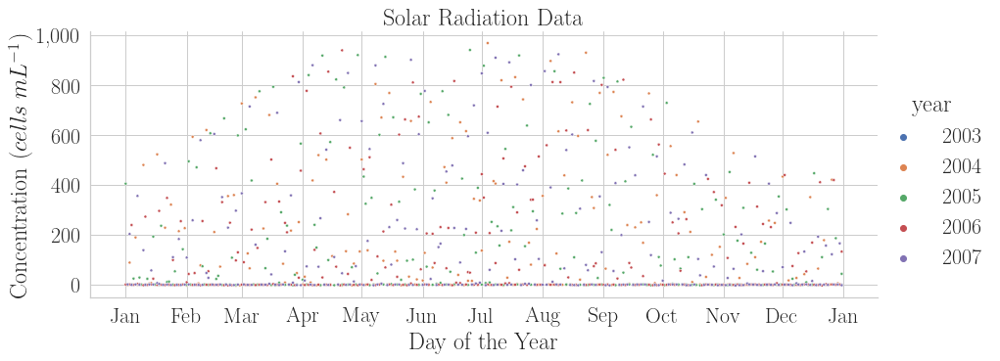

In [25]:
sns.relplot(kind='scatter', data=dfenv[dfenv["year"] <= 2007][::100], x='doy', y='solar', hue='year',
                aspect=2.5,
                marker='.',
               palette = "deep")
plt.gca().yaxis.set_major_formatter(plt.matplotlib.ticker.StrMethodFormatter('{x:,.0f}')) #adds commas to yaxis tick marks
plt.gca().xaxis.set_major_locator(MonthLocator())  # Tick locator
plt.gca().xaxis.set_major_formatter(DateFormatter('%b'))
plt.xlabel("Day of the Year")
plt.ylabel("Concentration $(cells$ $mL^{-1})$")
plt.title("Solar Radiation Data")

In [33]:
plt.figure(figsize=(15, 8), dpi=1000)

# for Palatino and other serif fonts use:
sns.set(font_scale = 2, style = "whitegrid")

plt.rcParams.update({
    "text.usetex": True,
    "font.family": "serif",
    "font.serif": ["Computer Modern Roman"]})

sns.scatterplot(data = dfenv[::50],x = "datetime", y = "temp_beam",marker = ".")
plt.xlabel("Year")
plt.ylabel("Temperature $(Deg C)$")
plt.title("Temperature at MVCO")

Text(0.5, 1.0, 'Temperature at MVCO')

## importing nutrient data



In [30]:
headers = pd.read_csv("/D/MIT-WHOI/github_repos/syn_model/data/mvco_nutrients_headers.csv",header = None)
heads = [str(x)[2:-2] for x in headers.values.tolist()] #converts imported csv into a list so you can rename columns

dfnut = pd.read_csv("/D/MIT-WHOI/github_repos/syn_model/data/mvco_nutrients.csv")
dfnut.columns = heads

dfnut["date"] = pd.to_datetime(dfnut["Start_Date"],format='%Y-%m-%d %H:%M:%S.%f').dt.date#reconverting to date column to datetime format
dfnut["time"] = pd.to_datetime(dfnut["Start_Time_UTC"],format='%Y-%m-%d %H:%M:%S.%f').dt.time#reconverting to date column to datetime format

dfnut["datetime"] = dfnut.apply(lambda r : pd.datetime.combine(r['date'],r['time']),1)
dfnut["month"] = pd.to_datetime(dfnut["datetime"].dt.month,format = "%m") #extracting month
dfnut["doy"] = pd.to_datetime(dfnut["datetime"].dt.dayofyear,format = "%j") #extracting day of year
dfnut["year"] = dfnut["datetime"].dt.year #extracting month

dfnut.head()




,Event_Number,Event_Number_Niskin,Start_Date,Start_Time_UTC,Latitude,Longitude,Depth,Nut_a_uM NO2- + NO3-,Nut_b_uM NO2- + NO3-,Nut_c_uM NO2- + NO3-,...,Nut_c_uM SiO2-,Nut_a_uM PO43-,Nut_b_uM PO43-,Nut_c_uM PO43-,date,time,datetime,month,doy,year
0,MVCO_005,MVCO_005_01,2003-06-25 00:00:00.0,1899-12-30 17:55:00.0,41.325,-70.566667,0.0,0.095023,NaN,NaN,...,NaN,0.464469,NaN,NaN,2003-06-25,17:55:00,2003-06-25 17:55:00,1900-06-01,1900-06-25,2003
1,MVCO_006,MVCO_006_01,2003-07-07 00:00:00.0,1899-12-30 18:10:00.0,41.325,-70.566667,0.0,0.052540,NaN,NaN,...,NaN,0.963674,NaN,NaN,2003-07-07,18:10:00,2003-07-07 18:10:00,1900-07-01,1900-07-07,2003
2,MVCO_008,MVCO_008_01,2003-07-31 00:00:00.0,1899-12-30 18:15:00.0,41.325,-70.566667,0.0,0.120062,0.115957,NaN,...,NaN,0.267963,0.214370,NaN,2003-07-31,18:15:00,2003-07-31 18:15:00,1900-07-01,1900-07-31,2003
3,MVCO_009,MVCO_009_01,2003-08-13 00:00:00.0,1899-12-30 17:30:00.0,41.325,-70.566667,0.0,0.000000,0.741919,NaN,...,NaN,0.371178,0.373163,NaN,2003-08-13,17:30:00,2003-08-13 17:30:00,1900-08-01,1900-08-13,2003
4,MVCO_010,MVCO_010_01,2003-08-15 00:00:00.0,1899-12-30 17:00:00.0,41.325,-70.566667,0.0,0.000000,0.000000,NaN,...,NaN,1.796344,1.468834,NaN,2003-08-15,17:00:00,2003-08-15 17:00:00,1900-08-01,1900-08-15,2003


In [35]:
plt.figure(figsize=(15, 8), dpi=1000)

# for Palatino and other serif fonts use:
sns.set(font_scale = 2, style = "whitegrid")

plt.rcParams.update({
    "text.usetex": True,
    "font.family": "serif",
    "font.serif": ["Computer Modern Roman"]})

sns.scatterplot(data = dfnut,x = "datetime", y = "Nut_a_uM NO2- + NO3-",marker = ".")
plt.xlabel("Year")
plt.ylabel(" Nitrate and Nitrite Concentrations$")
plt.title("Nutrients at MVCO")

Text(0.5, 1.0, 'Nutrients at MVCO')

RuntimeError: latex was not able to process the following string:
b' Nitrate and Nitrite Concentrations$'

Here is the full report generated by latex:
This is pdfTeX, Version 3.14159265-2.6-1.40.20 (TeX Live 2019/Debian) (preloaded format=latex)
 restricted \write18 enabled.
entering extended mode
(/home/miras/.cache/matplotlib/tex.cache/f4ee99b11e7cb1bd76d643bd9c0a927c.tex
LaTeX2e <2020-02-02> patch level 2
L3 programming layer <2020-02-14>
(/usr/share/texlive/texmf-dist/tex/latex/base/article.cls
Document Class: article 2019/12/20 v1.4l Standard LaTeX document class
(/usr/share/texlive/texmf-dist/tex/latex/base/size10.clo))
(/usr/share/texlive/texmf-dist/tex/latex/type1cm/type1cm.sty)
(/usr/share/texlive/texmf-dist/tex/latex/base/textcomp.sty)
(/usr/share/texlive/texmf-dist/tex/latex/base/inputenc.sty)
(/usr/share/texlive/texmf-dist/tex/latex/geometry/geometry.sty
(/usr/share/texlive/texmf-dist/tex/latex/graphics/keyval.sty)
(/usr/share/texlive/texmf-dist/tex/generic/iftex/ifvtex.sty
(/usr/share/texlive/texmf-dist/tex/generic/iftex/iftex.sty))

Package geometry Warning: Over-specification in `h'-direction.
    `width' (5058.9pt) is ignored.


Package geometry Warning: Over-specification in `v'-direction.
    `height' (5058.9pt) is ignored.

) (/usr/share/texlive/texmf-dist/tex/latex/l3backend/l3backend-dvips.def)
(./f4ee99b11e7cb1bd76d643bd9c0a927c.aux)
*geometry* driver: auto-detecting
*geometry* detected driver: dvips
! Extra }, or forgotten $.
<recently read> }
                 
l.14 ...mily  Nitrate and Nitrite Concentrations$}
                                                  
No pages of output.
Transcript written on f4ee99b11e7cb1bd76d643bd9c0a927c.log.




<Figure size 15000x8000 with 1 Axes>